# Movie Rating Distributions

#### Grading:


- Code: 90 pts
- Markdown Documentation: 10 pts


In this assignment we are going understand distributions

In [395]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
from IPython.display import HTML, display
import plotly.graph_objects as go
from IPython.display import Image

pd.set_option('display.notebook_repr_html', False)
pd.set_option('display.max_columns', 20)
pd.set_option('display.max_rows', 25)

In [85]:
%matplotlib inline

##### Read in the movie data: `pd.read_table`

In [86]:
def get_movie_data():
    
    unames = ['user_id','gender','age','occupation','zip']
    users = pd.read_table(os.path.join('../data','users.dat'), 
                          sep='::', header=None, names=unames, encoding='latin-1')
    
    rnames = ['user_id', 'movie_id', 'rating', 'timestamp']
    ratings = pd.read_table(os.path.join('../data', 'ratings.dat'), 
                            sep='::', header=None, names=rnames, encoding='latin-1')
    
    mnames = ['movie_id', 'title','genres']
    movies = pd.read_table(os.path.join('../data', 'movies.dat'), 
                           sep='::', header=None, names=mnames, encoding='latin-1')

    return users, ratings, movies

In [87]:
users, ratings, movies = get_movie_data()

C:\Users\varsh\AppData\Local\Temp\ipykernel_29764\449773986.py:4: ParserWarning:

Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.

C:\Users\varsh\AppData\Local\Temp\ipykernel_29764\449773986.py:8: ParserWarning:

Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.

C:\Users\varsh\AppData\Local\Temp\ipykernel_29764\449773986.py:12: ParserWarning:

Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.



In [88]:
print(users.head())

   user_id gender  age  occupation    zip
0        1      F    1          10  48067
1        2      M   56          16  70072
2        3      M   25          15  55117
3        4      M   45           7  02460
4        5      M   25          20  55455


In [89]:
print(ratings.head())

   user_id  movie_id  rating  timestamp
0        1      1193       5  978300760
1        1       661       3  978302109
2        1       914       3  978301968
3        1      3408       4  978300275
4        1      2355       5  978824291


In [90]:
print(movies.head())

   movie_id                               title                        genres
0         1                    Toy Story (1995)   Animation|Children's|Comedy
1         2                      Jumanji (1995)  Adventure|Children's|Fantasy
2         3             Grumpier Old Men (1995)                Comedy|Romance
3         4            Waiting to Exhale (1995)                  Comedy|Drama
4         5  Father of the Bride Part II (1995)                        Comedy


##### Clean up the `movies`

- Get the `year`
- Shorten the `title`


In [91]:
tmp = movies.title.str.extract('(.*) \(([0-9]+)\)')
tmp.apply(lambda x:x[0] if len(x) > 0 else None)
tmp.apply(lambda x: x[0][:40] if len(x) > 0 else None)

0    Toy Story
1         1995
dtype: object

In [92]:
movies['year'] = tmp[1]
movies['short_title'] = tmp[0]

In [93]:
print(movies.head())

   movie_id                               title                        genres  \
0         1                    Toy Story (1995)   Animation|Children's|Comedy   
1         2                      Jumanji (1995)  Adventure|Children's|Fantasy   
2         3             Grumpier Old Men (1995)                Comedy|Romance   
3         4            Waiting to Exhale (1995)                  Comedy|Drama   
4         5  Father of the Bride Part II (1995)                        Comedy   

   year                  short_title  
0  1995                    Toy Story  
1  1995                      Jumanji  
2  1995             Grumpier Old Men  
3  1995            Waiting to Exhale  
4  1995  Father of the Bride Part II  


# 1. What is the overal distribution of ratings (20 pts)

### Describe the distribution and its properties

- Shape : The distribution of movie ratings is skewed left. There is a concentration of data towards higher ratings and a slightly long tail to the left. The vast majority movies recieved higher ratings.

- Peak : The data is unimodal and seen to peak at the rating 4 . 

- Spread : Each of the rating categories (1 - 5) was picked by at least 1 user i.e. there was no rating that was not picked by the user population.

- Mean & Median charecteristics : The data seem to be centered around 3 to 4 rating. This implies that roughly half the population of ratings given were 1, 2, 3 and the other half were 4 & 5

### Mean of ratings

Calculating the mean for overall movie ratings 

In [12]:
ratings["rating"].mean()

3.581564453029317

In [97]:
fig = go.Figure(data=[go.Histogram(x=ratings.rating)])
fig.add_vline(ratings.rating.mean(), line_width=5, line_dash="dash", line_color="red")
fig.show()

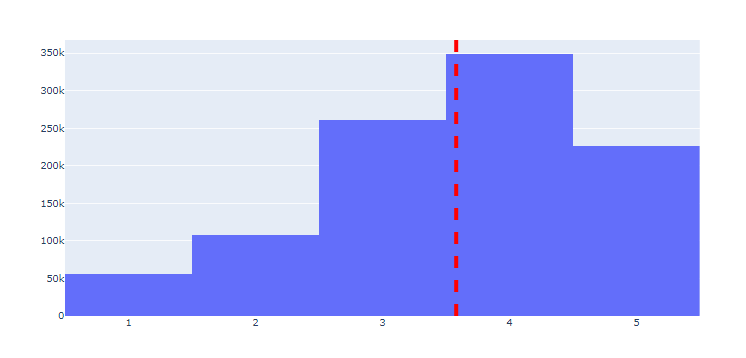

In [127]:
Image("screenshots/mean.png")

### Median of ratings 

Calculating the median for overall movie ratings 

In [104]:
ratings["rating"].median()

4.0

In [20]:
fig = go.Figure(data=[go.Histogram(x=ratings.rating)])
fig.add_vline(ratings.rating.median(), line_width=5, line_dash="dash", line_color="green")
fig.show()

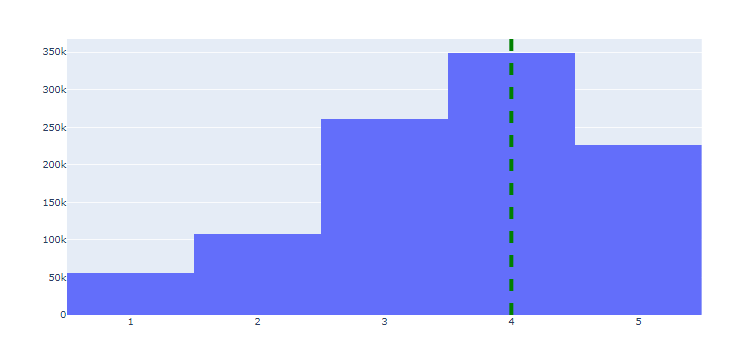

In [126]:
Image("screenshots/median.png")

### 5 number summary

Calculating the 5 number summary for overall movie ratings by using describe

In [ ]:
ratings["rating"].describe()

### Skew

In [ ]:
ratings.skew()

In [18]:
ratings["rating"].skew()

-0.5536098874940055

### Kurtoisis

In [ ]:
ratings.kurt()

In [17]:
ratings["rating"].kurt()

-0.3519708031404196

### Describe the type distribution and why?

In [24]:
fig = go.Figure(data=[go.Histogram(x=ratings.rating)])
fig.show()

> The ratings data seems to follow a **Multinominal distribution** which is a type of **Categorical Distribution**. A categorical Distribution is described as a discrete probability distribution that describes the probability that a random variable will take on a value that belongs to one of K categories, where each category has a probability associated with it. For a distribution to be classified as a Multinomial distribution type within a categorical distribution, it must have K ≥ 2 potential outcomes and n ≥ 1 trial. 

- In this case we oserve 
1. There are 5 discrete categories for rating (satifying K ≥ 2 potential outcomes)
2. if a user randomly selects a rating for the movie there are 5 potentially discreet outcomes
3. The liklihood/probability of a user selecting any one of these 5 discreet outcomes is 1/5 (which is between the values 0 and 1)
3. The sum of all the probabilities adds up to a 1 (1/5+ 1/5+ 1/5+ 1/5+ 1/5)

# 2. What's the distribution of average ratings of movies in action vs drama genres? (20 pts))

In [72]:
movies_ratings = (ratings
                  .set_index("movie_id")
                  .join(movies.set_index("movie_id"),
                        how="left")
                 )
genres_dummies = movies_ratings['genres'].str.get_dummies()

In [76]:
full_movies_ratings = (pd.concat([movies_ratings, genres_dummies], axis=1)
                       .drop(["timestamp"], axis=1)
                )
full_movies_ratings.reset_index(inplace=True)

In [326]:
full_users_ratings_movies = pd.merge(users, full_movies_ratings, on=['user_id'], how='inner').drop(["occupation", "zip","age","gender"],axis=1)
full_users_ratings_movies

         user_id  movie_id  rating  \
0              1         1       5   
1              1        48       5   
2              1       150       5   
3              1       260       4   
4              1       527       5   
...          ...       ...     ...   
1000204     6040      3683       4   
1000205     6040      3703       4   
1000206     6040      3735       4   
1000207     6040      3751       4   
1000208     6040      3819       5   

                                              title  \
0                                  Toy Story (1995)   
1                                 Pocahontas (1995)   
2                                  Apollo 13 (1995)   
3         Star Wars: Episode IV - A New Hope (1977)   
4                           Schindler's List (1993)   
...                                             ...   
1000204                         Blood Simple (1984)   
1000205  Mad Max 2 (a.k.a. The Road Warrior) (1981)   
1000206                              Serpico (19

In [82]:
full_users_ratings_movies.isnull().sum()

user_id        0
movie_id       0
rating         0
title          0
genres         0
year           0
short_title    0
Action         0
Adventure      0
Animation      0
Children's     0
Comedy         0
Crime          0
Documentary    0
Drama          0
Fantasy        0
Film-Noir      0
Horror         0
Musical        0
Mystery        0
Romance        0
Sci-Fi         0
Thriller       0
War            0
Western        0
dtype: int64

### Average ratings of movies in Action

In [334]:
cols= ["movie_id","rating","Action"]
condition = full_users_ratings_movies["Action"] == 1

Action = (full_users_ratings_movies
          [cols]
         [condition].drop("Action",axis=1)
         )
Action

         movie_id  rating
3             260       4
23           1197       3
27           1287       5
36           2028       5
43           2692       4
...           ...     ...
1000152      2872       4
1000158      2985       2
1000160      2989       2
1000190      3418       3
1000205      3703       4

[257457 rows x 2 columns]

In [335]:
Action.rating.mean()

3.4911849357368414

> Mean ratings for all movies in Action genres

In [338]:
Action_group = Action.groupby(['movie_id'])['rating'].mean()
Action_group = Action_group.reset_index()
Action_group

     movie_id    rating
0           6  3.878723
1           9  2.656863
2          10  3.540541
3          15  2.458904
4          20  2.537500
..        ...       ...
490      3877  2.021978
491      3879  2.784722
492      3889  2.414815
493      3898  2.733333
494      3946  2.260000

[495 rows x 2 columns]

> overall mean ratings for Action movies

In [346]:
print('Mean rating for Action movies = ',Action_group.rating.mean())

Mean rating for Action movies =  3.0982950095336244


In [347]:
fig = go.Figure(data=[go.Histogram(x=Action_group.rating)])
fig.add_vline(Action_group.rating.mean(), line_width=5, line_dash="dash", line_color="red")
fig.show()

### Average ratings of movies in Drama

In [341]:
cols= ["movie_id","rating","Drama"]
condition = full_users_ratings_movies["Drama"] == 1

Drama = (full_users_ratings_movies
          [cols]
         [condition].drop("Drama",axis=1)
         )
Drama

         movie_id  rating
2             150       5
4             527       5
5             531       4
9             608       4
15            919       4
...           ...     ...
1000198      3521       5
1000200      3543       4
1000201      3547       4
1000204      3683       4
1000206      3735       4

[354529 rows x 2 columns]

In [342]:
Drama.rating.mean()

3.766332232342065

> Mean ratings for all movies in Drama genres 

In [343]:
Drama_group = Drama.groupby(['movie_id'])['rating'].mean()
Drama_group = Drama_group.reset_index()
Drama_group

      movie_id    rating
0            4  2.729412
1           11  3.793804
2           14  3.542484
3           16  3.793255
4           17  4.027545
...        ...       ...
1488      3946  2.260000
1489      3949  4.115132
1490      3950  3.666667
1491      3951  3.900000
1492      3952  3.780928

[1493 rows x 2 columns]

> overall mean ratings for Drama movies

In [349]:
print('Mean rating for Drama movies = ',Drama_group.rating.mean())

Mean rating for Drama movies =  3.4153311410028575


In [345]:
fig = go.Figure(data=[go.Histogram(x=Drama_group.rating)])
fig.add_vline(Drama_group.rating.mean(), line_width=5, line_dash="dash", line_color="red")
fig.show()

# 3. Develop distribution estimators for the action vs drama genres?? (60 pts)

- Create MoM, MLE, and KDE estimates for each category 
- Compare between them to see what the differences are
- Describe the results

### Histogram for Average ratings of movies in Action genres

In [350]:
fig = go.Figure(data=[go.Histogram(x=Action_group.rating)])
fig.show()

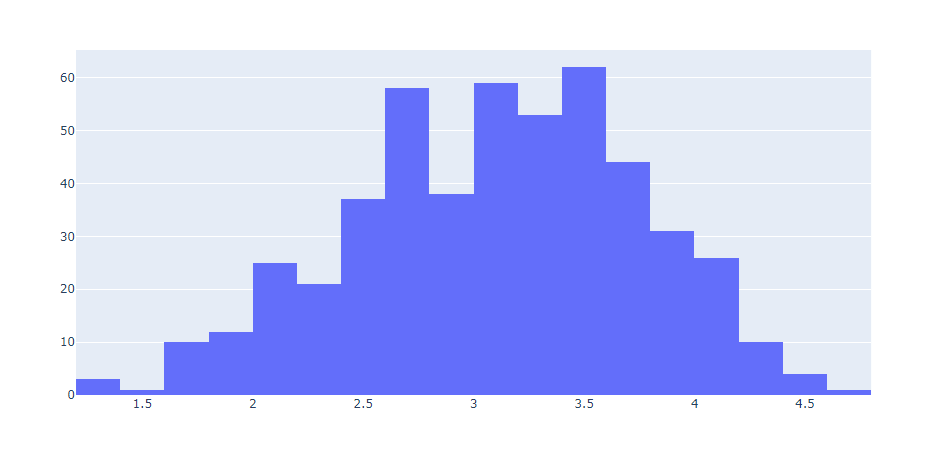

In [396]:
Image("screenshots/action.png")

### Histogram for Average ratings of movies in Drama genres

In [364]:
fig = go.Figure(data=[go.Histogram(x=Drama_group.rating)])
fig.show()

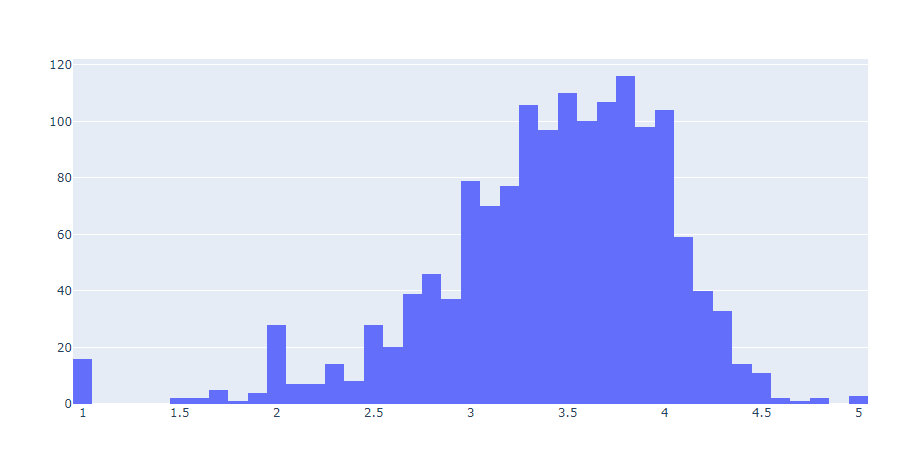

In [397]:
Image("screenshots/drama.png")

#### When we look at the data, we notice that all of it is positive values and the data is continuous which are both charecteristics of a Gamma Distribution. That said one deviation we observe from a Gamma distribution is the type of skew. for the purpose of the assignment I am overlooking this deviation and assuming that the data follows a Gamma Distribution. 

#### Method of Moments

##### Drama

In [354]:
Drama_group.fillna(value={'rating': Drama_group.mean()}, inplace=True)

In [355]:
D_mean = Drama_group.rating.mean()
D_mean

3.4153311410028575

In [356]:
D_var =  Drama_group.rating.var()
D_var

0.3726698330993363

In [357]:
D_alpha_mom = D_mean ** 2 /D_var
D_beta_mom =D_var /D_mean

In [358]:
print(D_alpha_mom)

31.299788087743273


In [359]:
print(D_beta_mom)

0.10911674965429788


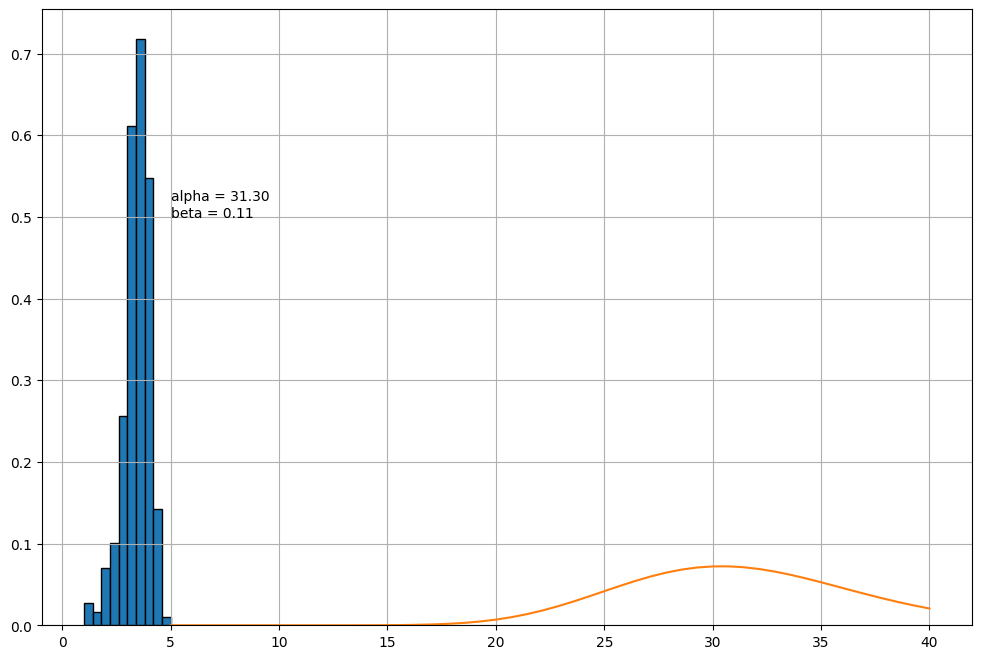

In [367]:
from scipy.stats.distributions import gamma
Drama_group.rating.hist(density=True, bins=10, ec='black', figsize=(12,8))
label = 'alpha = {0:.2f}\nbeta = {1:.2f}'.format(D_alpha_mom, D_beta_mom)
plt.annotate(label, xy=(5, 0.5))
plt.plot(np.linspace(40, 5), gamma.pdf(np.linspace(40, 5), D_alpha_mom, D_beta_mom))

Plot the histogram distribution along with the estimator as shown in class.

##### Action

In [310]:
Action_group.fillna(value={'mean': Drama_group.mean()}, inplace=True)

C:\Users\varsh\AppData\Local\Temp\ipykernel_29764\688936653.py:1: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [295]:
A_mean = Action_group.rating.mean()
A_mean

3.0063487200629697

In [296]:
A_var = Action_group.rating.var()
A_var

0.3560238329360148

In [305]:
A_alpha_mom = A_mean ** 2 /A_var
A_beta_mom =A_var /A_mean

In [306]:
print(A_alpha_mom)

25.38631347258318


In [307]:
print(A_beta_mom)

0.11842399737597895


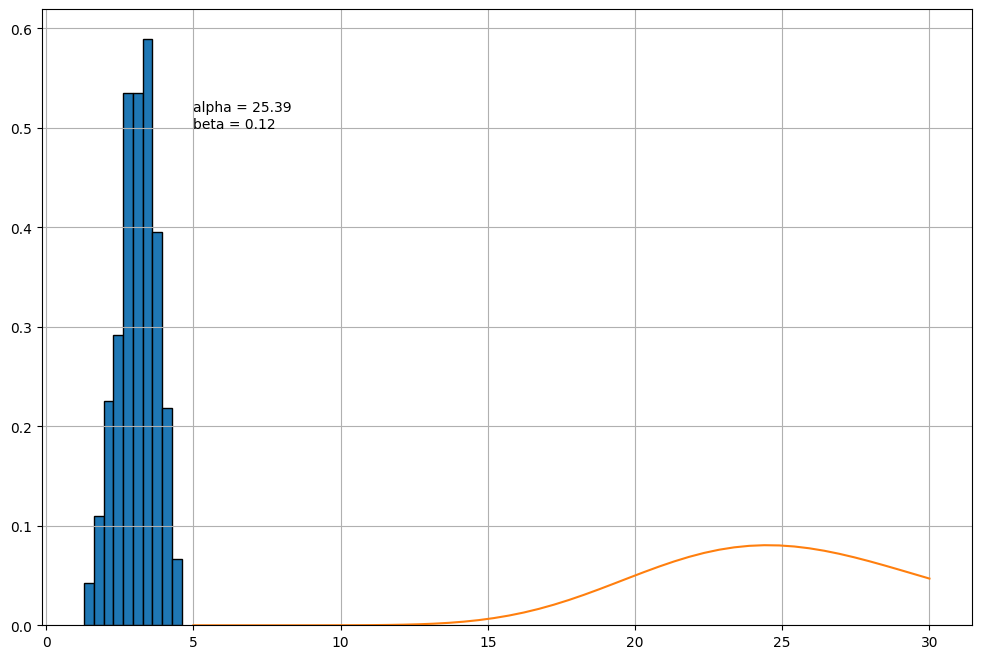

In [371]:
Action_group.rating.hist(density=True, bins=10, ec='black', figsize=(12,8))
label = 'alpha = {0:.2f}\nbeta = {1:.2f}'.format(A_alpha_mom, A_beta_mom)
plt.annotate(label, xy=(5, 0.5))
plt.plot(np.linspace(30, 5), gamma.pdf(np.linspace(30, 5), A_alpha_mom, A_beta_mom))

#### Maximum Likelihood

##### Drama

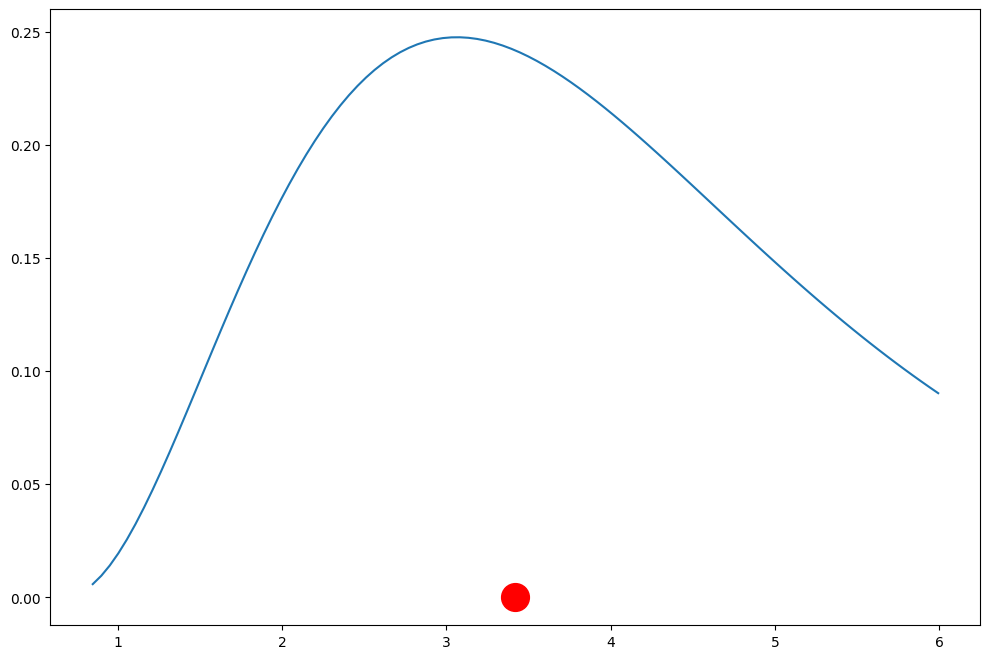

In [385]:
plt.figure(figsize=(12,8))
mu =  3.421508
sigma = 0.643119
x = np.linspace(mu - 4*sigma, mu + 4*sigma, 100)
plt.plot(x, stats.gamma.pdf(x, mu, sigma))
plt.plot(3.421508, 0, marker='o', markersize=20, color="red")
plt.show()


##### Action

In [373]:
Action_group.describe()

          movie_id      rating
count   495.000000  495.000000
mean   1954.678788    3.098295
std    1136.915217    0.651570
min       6.000000    1.285714
25%    1042.000000    2.653802
50%    1912.000000    3.151079
75%    2886.500000    3.563500
max    3946.000000    4.608696

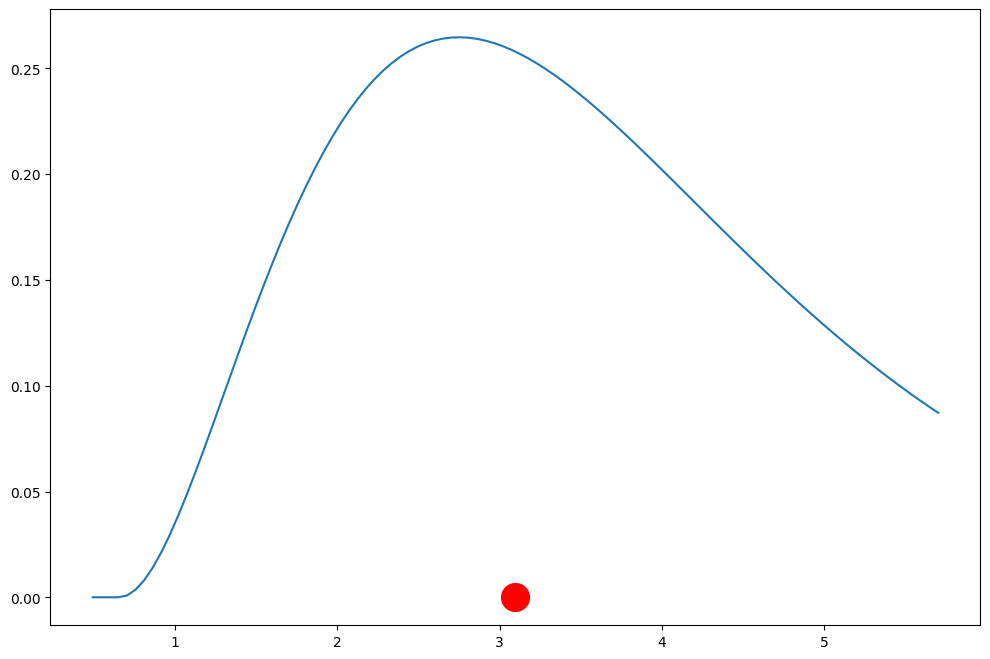

In [386]:
plt.figure(figsize=(12,8))
mu =  3.098295
sigma = 0.651570
x = np.linspace(mu - 4*sigma, mu + 4*sigma, 100)
plt.plot(x, stats.gamma.pdf(x, mu, sigma))
plt.plot( 3.098295, 0, marker='o', markersize=20, color="red")
plt.show()


#### KDE

##### Drama

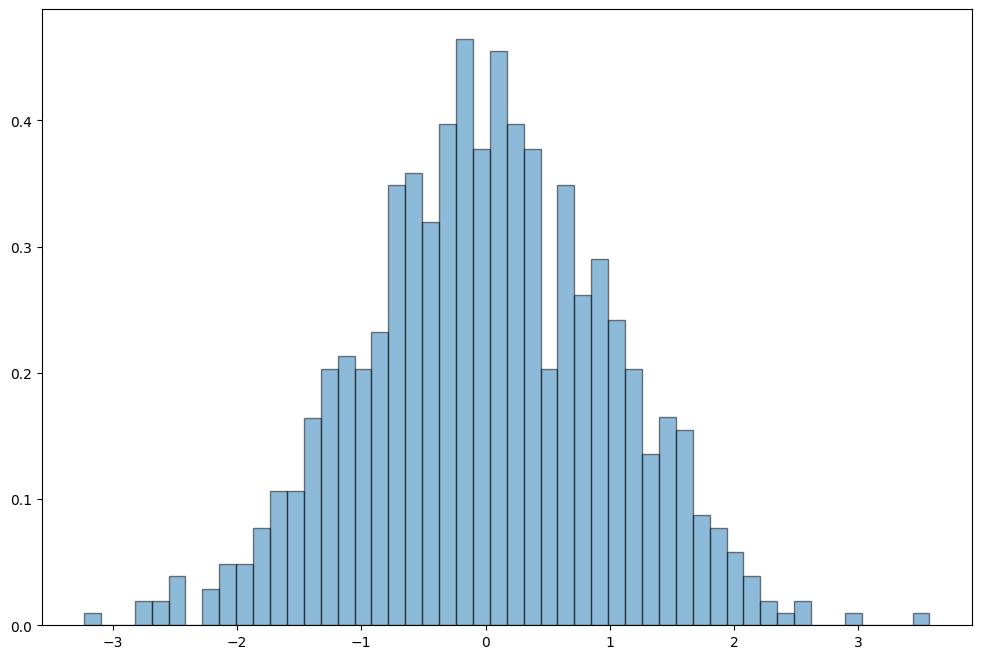

In [394]:
data1 = stats.gamma.rvs(loc=0, scale=5, a=759, random_state=100)
plt.figure(figsize=(12,8))
plt.hist(data, 50, density=1, alpha=0.5, ec='black');

AttributeError: Rectangle.set() got an unexpected keyword argument 'normed'

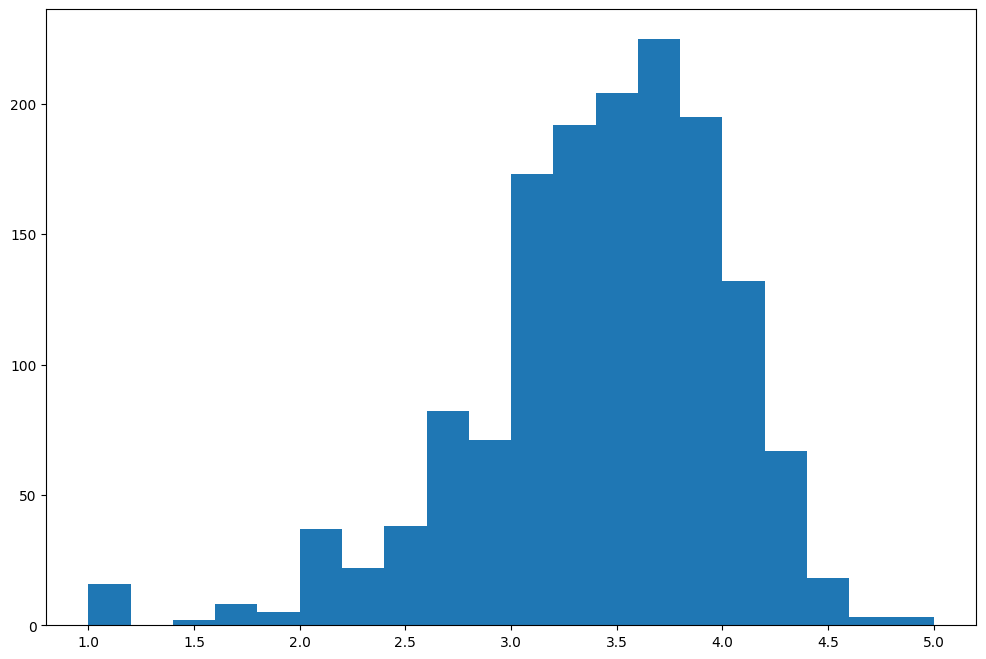

In [389]:
from scipy.stats import kde
drama = Drama_group.rating
drama.hist(normed=True, bins=20, grid=False, ec='black', figsize=(12,8))
x = np.linspace(0, drama.max())
density = kde.gaussian_kde(drama, bw_method=None)
xgrid = np.linspace(x.min(), x.max(), 100)

plt.plot(x, density(x), 'y--')

ValueError: `dataset` input should have multiple elements.

##### Action

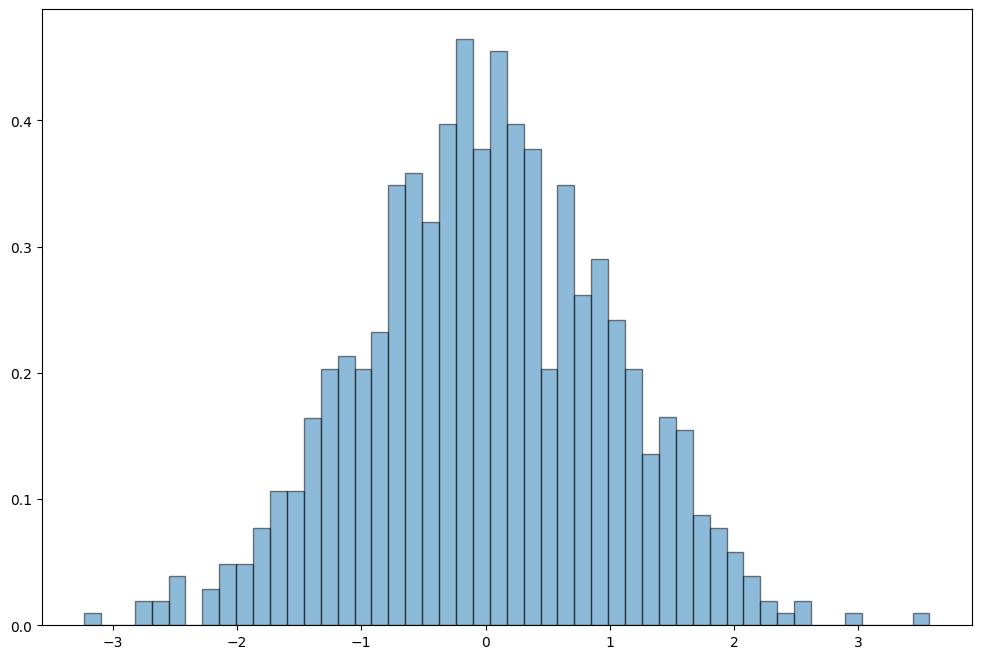

In [391]:
data1 = stats.gamma.rvs(loc=0, scale=5, a=759, random_state=100)
plt.figure(figsize=(12,8))
plt.hist(data, 50, density=1, alpha=0.5, ec='black');

AttributeError: Rectangle.set() got an unexpected keyword argument 'normed'

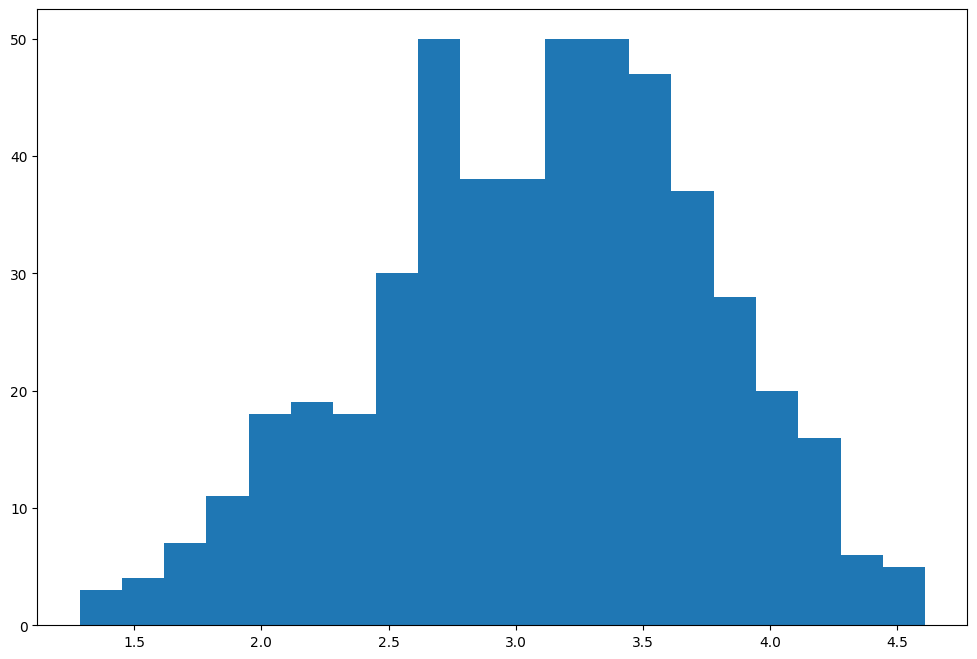

In [393]:
from scipy.stats import kde
action = Action_group.rating
action.hist(normed=True, bins=20, grid=False, ec='black', figsize=(12,8))
x = np.linspace(0, drama.max())
density = kde.gaussian_kde(action, bw_method=None)
xgrid = np.linspace(x.min(), x.max(), 100)

plt.plot(x, density(x), 'y--')

In [392]:
# test values for the bw_method option ('None' is the default value)
bw_values =  [None, 0.1, 0.01]

# generate a list of kde estimators for each bw
kde = [stats.gaussian_kde(data1,bw_method=bw) for bw in bw_values]

plt.figure(figsize=(12,8))

plt.hist(data1, 50, density=1, alpha=0.5,ec='black');

# plot density estimates
t_range = np.linspace(-2,8,200)
for i, bw in enumerate(bw_values):
    plt.plot(t_range,kde[i](t_range),lw=2, label='bw = '+str(bw))
plt.xlim(-1,6)
plt.legend(loc='best')

ValueError: `dataset` input should have multiple elements.